In [ ]:
%%capture
!pip install diffusers

In [ ]:
%%capture
!pip install accelerate

In [ ]:
import torch
import tqdm
import numpy as np

from PIL import Image
from tqdm.auto import tqdm
from google.colab import drive

from diffusers import UNet2DModel
from diffusers import DDPMPipeline
from diffusers import DDPMScheduler
from diffusers import DDIMPipeline
from diffusers import DDIMScheduler

torch.manual_seed(200)

In [ ]:
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
model_id = "google/ddpm-celebahq-256"
model = UNet2DModel.from_pretrained(model_id)
ddpm_scheduler = DDPMScheduler.from_config(model_id)
ddpm_pipeline = DDPMPipeline(unet=model, scheduler=ddpm_scheduler)
ddpm_pipeline.to("cuda")

DDPMPipeline {
  "_class_name": "DDPMPipeline",
  "_diffusers_version": "0.12.1",
  "scheduler": [
    "diffusers",
    "DDPMScheduler"
  ],
  "unet": [
    "diffusers",
    "UNet2DModel"
  ]
}

In [ ]:
model

UNet2DModel(
  (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=128, out_features=512, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=512, out_features=512, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0): ResnetBlock2D(
          (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
          (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=512, out_features=128, bias=True)
          (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
        (1): ResnetBlock2D(
          (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
          (c

In [ ]:
model.config

FrozenDict([('sample_size', 256),
            ('in_channels', 3),
            ('out_channels', 3),
            ('center_input_sample', False),
            ('time_embedding_type', 'positional'),
            ('freq_shift', 1),
            ('flip_sin_to_cos', False),
            ('down_block_types',
             ['DownBlock2D',
              'DownBlock2D',
              'DownBlock2D',
              'DownBlock2D',
              'AttnDownBlock2D',
              'DownBlock2D']),
            ('up_block_types',
             ['UpBlock2D',
              'AttnUpBlock2D',
              'UpBlock2D',
              'UpBlock2D',
              'UpBlock2D',
              'UpBlock2D']),
            ('block_out_channels', [128, 128, 256, 256, 512, 512]),
            ('layers_per_block', 2),
            ('mid_block_scale_factor', 1),
            ('downsample_padding', 0),
            ('act_fn', 'silu'),
            ('attention_head_dim', None),
            ('norm_num_groups', 32),
            ('norm_eps', 

In [ ]:
ddpm_scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.0001),
            ('beta_end', 0.02),
            ('beta_schedule', 'linear'),
            ('trained_betas', None),
            ('variance_type', 'fixed_small'),
            ('clip_sample', True),
            ('prediction_type', 'epsilon'),
            ('_class_name', 'DDPMScheduler'),
            ('_diffusers_version', '0.1.1')])

In [ ]:
noisy_sample = torch.randn(
    1, model.config.in_channels, model.config.sample_size, model.config.sample_size
)
noisy_sample.shape

torch.Size([1, 3, 256, 256])

In [ ]:
def display_sample(sample, i):
    image = sample.cpu().permute(0, 2, 3, 1)
    image = (image + 1.0) * 127.5
    image = image.numpy().astype(np.uint8)
    image = Image.fromarray(image[0])
    image_name = str(i) + ".jpg"
    path = "/content/gdrive/MyDrive/Progetto_AML/ddpm_example_images/" + image_name
    image.save(path)
    display(f"Image at step {i}")
    display(image)

In [ ]:
model.to("cuda")
noisy_sample = noisy_sample.to("cuda")

  0%|          | 0/1000 [00:00<?, ?it/s]

'Image at step 10'

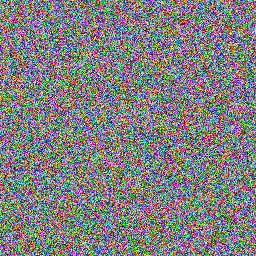

'Image at step 20'

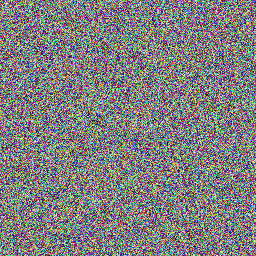

'Image at step 30'

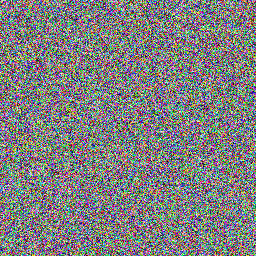

'Image at step 40'

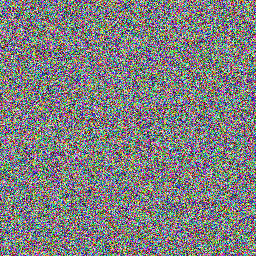

'Image at step 50'

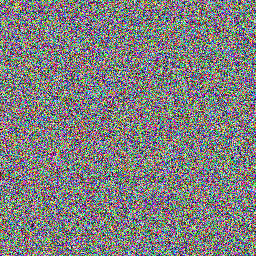

'Image at step 60'

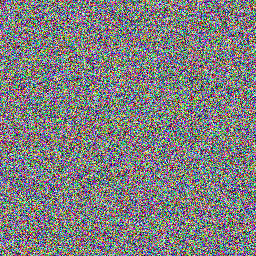

'Image at step 70'

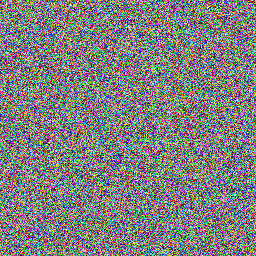

'Image at step 80'

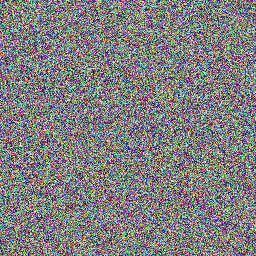

'Image at step 90'

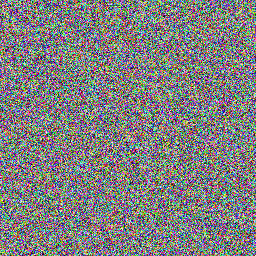

'Image at step 100'

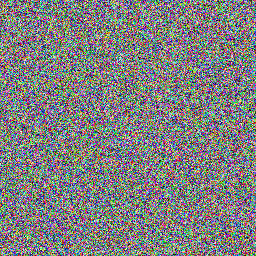

'Image at step 110'

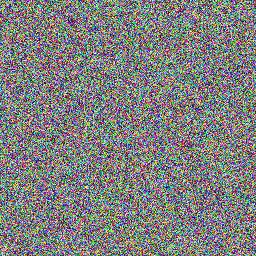

'Image at step 120'

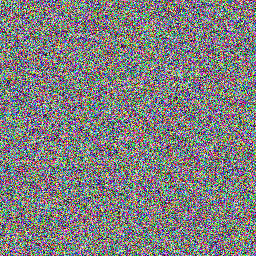

'Image at step 130'

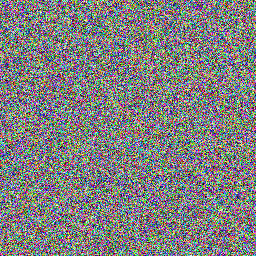

'Image at step 140'

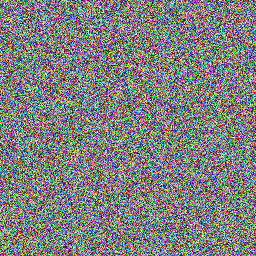

'Image at step 150'

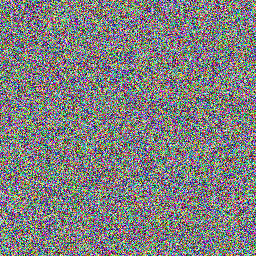

'Image at step 160'

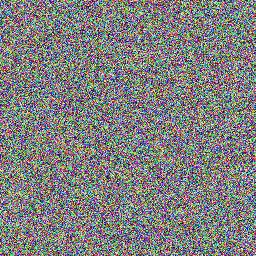

'Image at step 170'

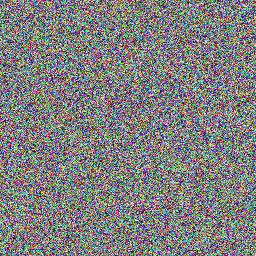

'Image at step 180'

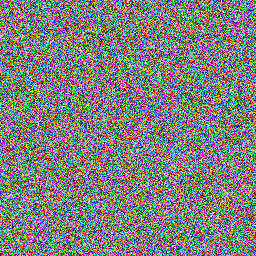

'Image at step 190'

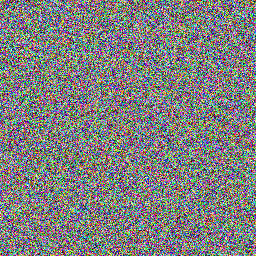

'Image at step 200'

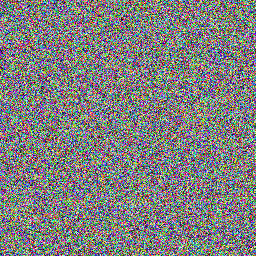

'Image at step 210'

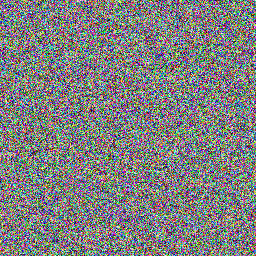

'Image at step 220'

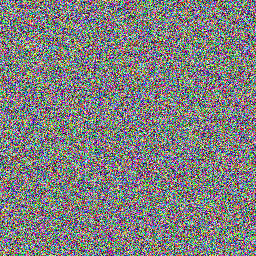

'Image at step 230'

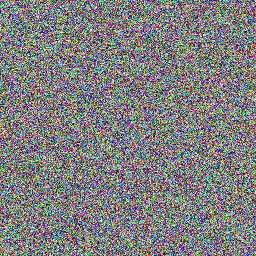

'Image at step 240'

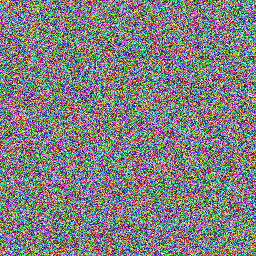

'Image at step 250'

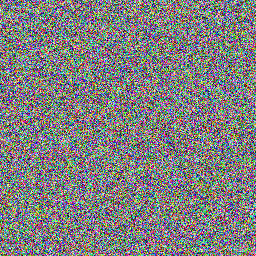

'Image at step 260'

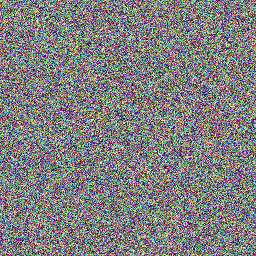

'Image at step 270'

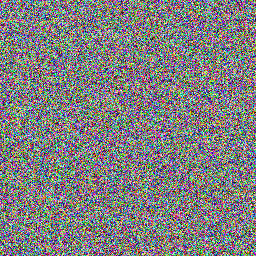

'Image at step 280'

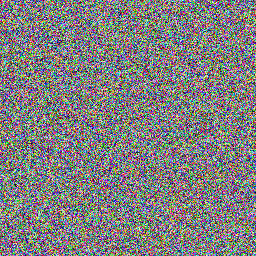

'Image at step 290'

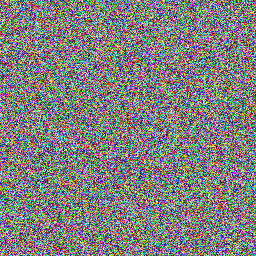

'Image at step 300'

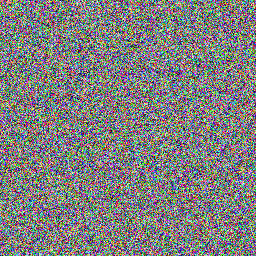

'Image at step 310'

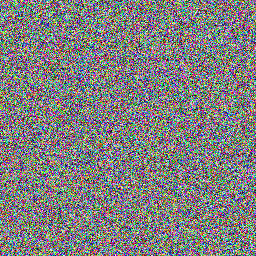

'Image at step 320'

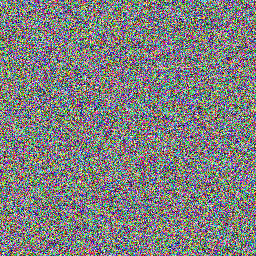

'Image at step 330'

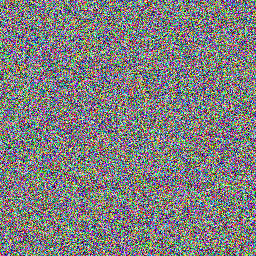

'Image at step 340'

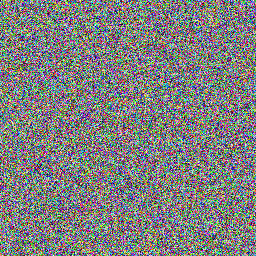

'Image at step 350'

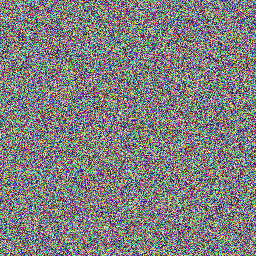

'Image at step 360'

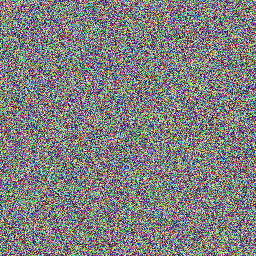

'Image at step 370'

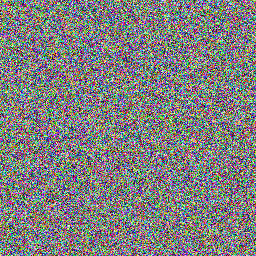

'Image at step 380'

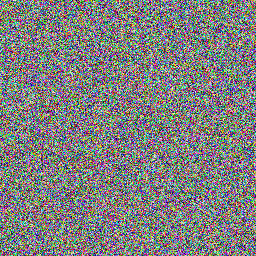

'Image at step 390'

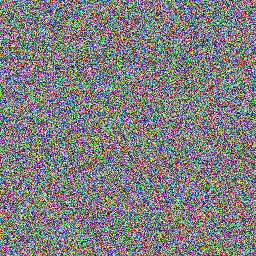

'Image at step 400'

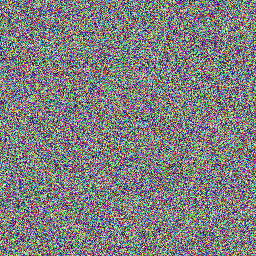

'Image at step 410'

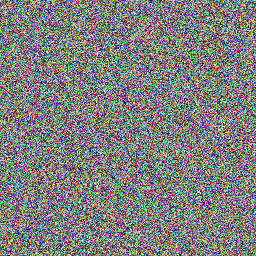

'Image at step 420'

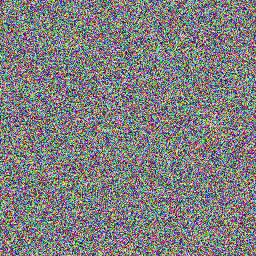

'Image at step 430'

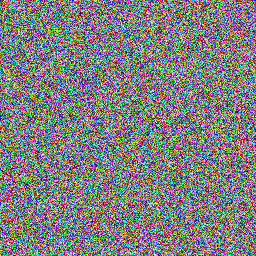

'Image at step 440'

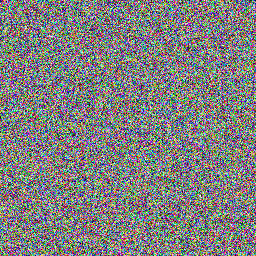

'Image at step 450'

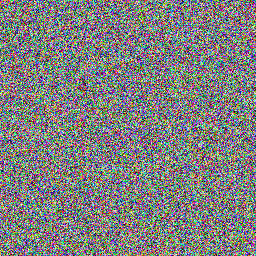

'Image at step 460'

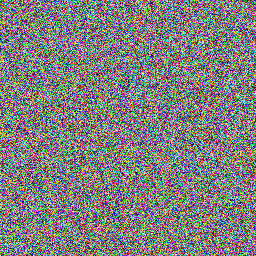

'Image at step 470'

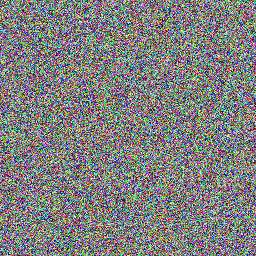

'Image at step 480'

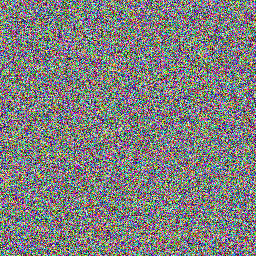

'Image at step 490'

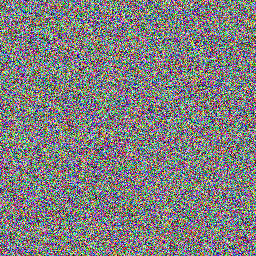

'Image at step 500'

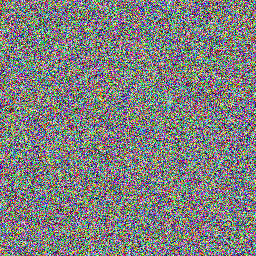

'Image at step 510'

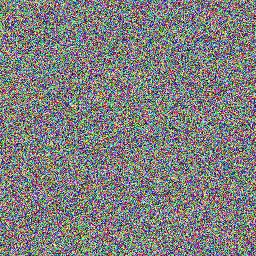

'Image at step 520'

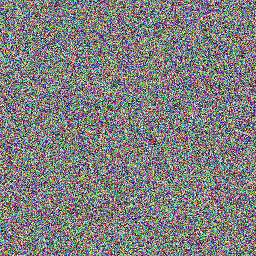

'Image at step 530'

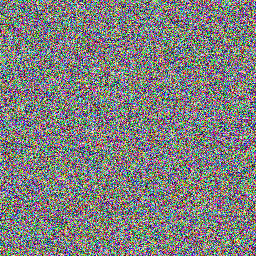

'Image at step 540'

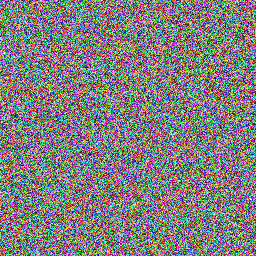

'Image at step 550'

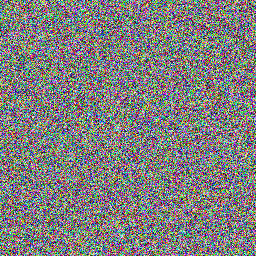

'Image at step 560'

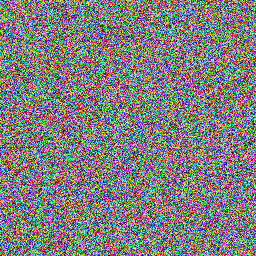

'Image at step 570'

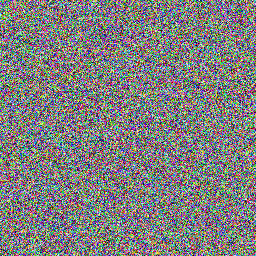

'Image at step 580'

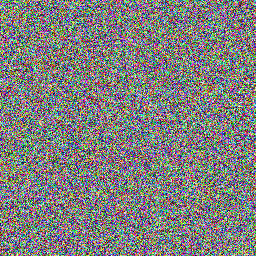

'Image at step 590'

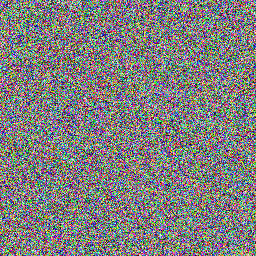

'Image at step 600'

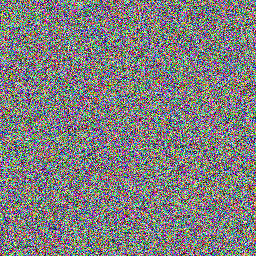

'Image at step 610'

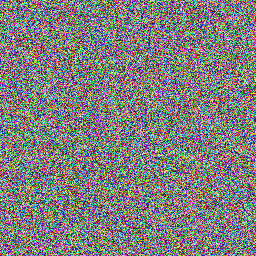

'Image at step 620'

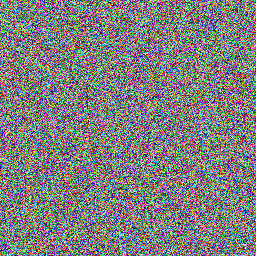

'Image at step 630'

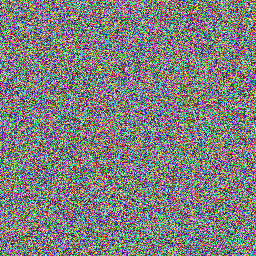

'Image at step 640'

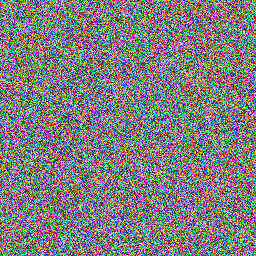

'Image at step 650'

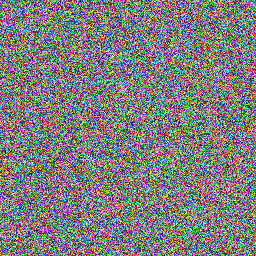

'Image at step 660'

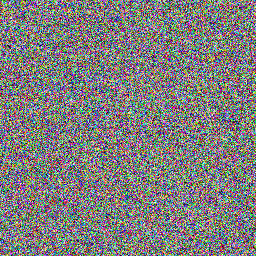

'Image at step 670'

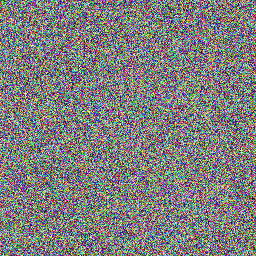

'Image at step 680'

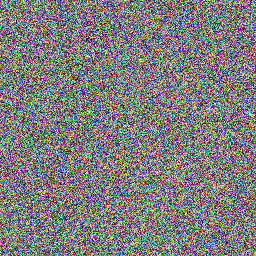

'Image at step 690'

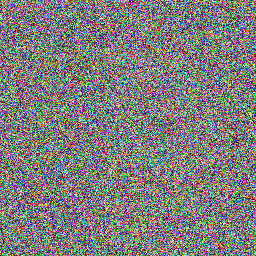

'Image at step 700'

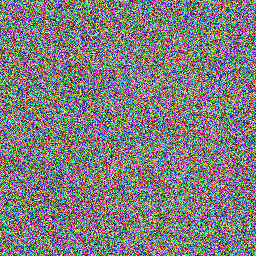

'Image at step 710'

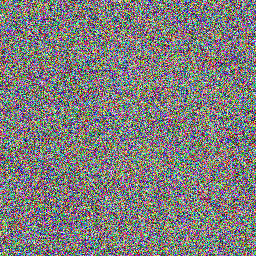

'Image at step 720'

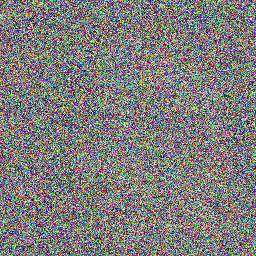

'Image at step 730'

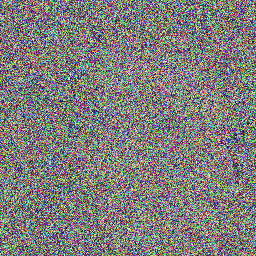

'Image at step 740'

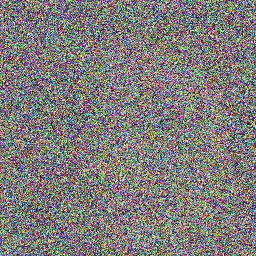

'Image at step 750'

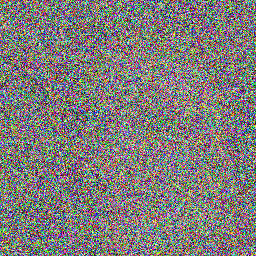

'Image at step 760'

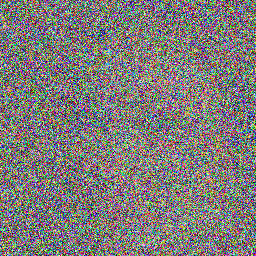

'Image at step 770'

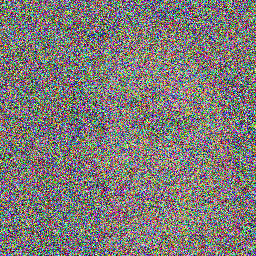

'Image at step 780'

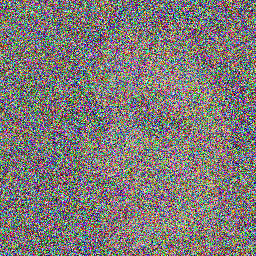

'Image at step 790'

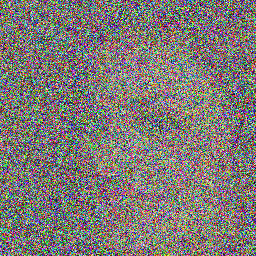

'Image at step 800'

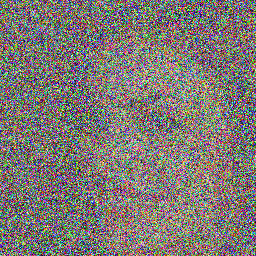

'Image at step 810'

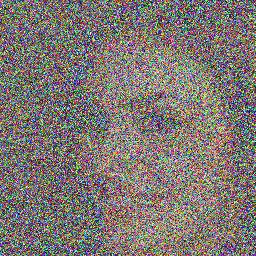

'Image at step 820'

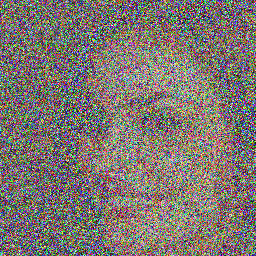

'Image at step 830'

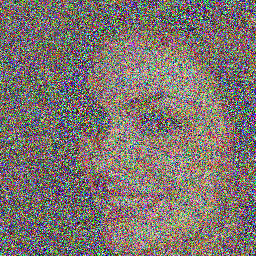

'Image at step 840'

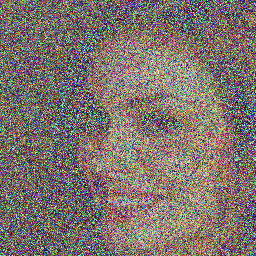

'Image at step 850'

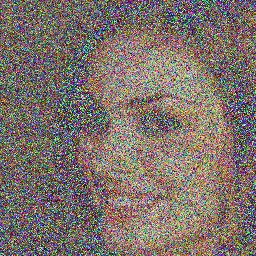

'Image at step 860'

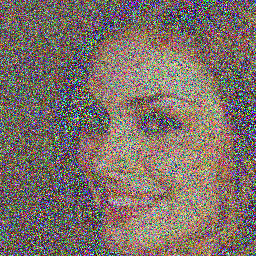

'Image at step 870'

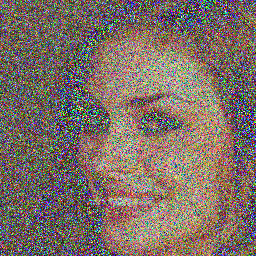

'Image at step 880'

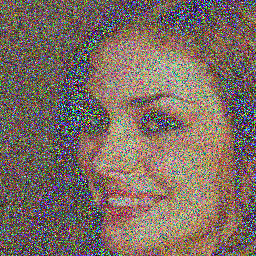

'Image at step 890'

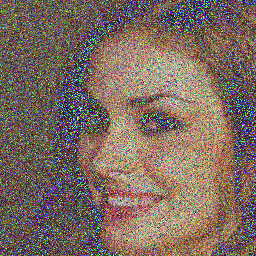

'Image at step 900'

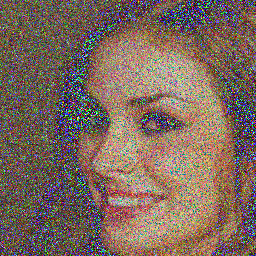

'Image at step 910'

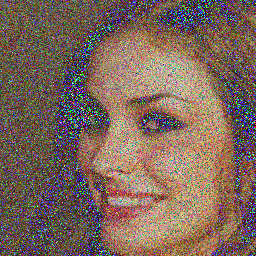

'Image at step 920'

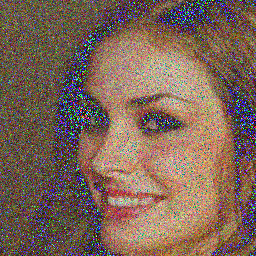

'Image at step 930'

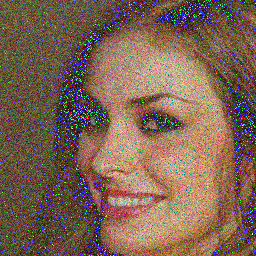

'Image at step 940'

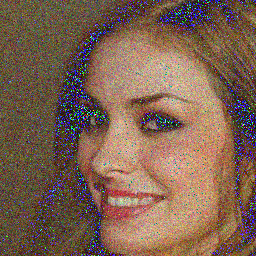

'Image at step 950'

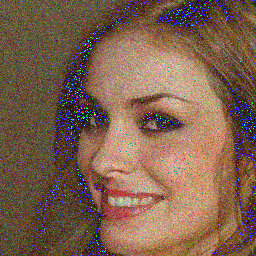

'Image at step 960'

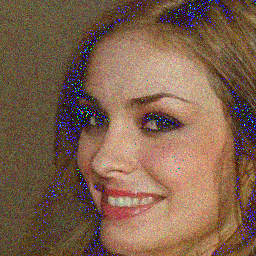

'Image at step 970'

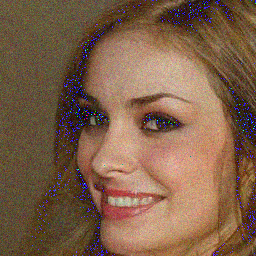

'Image at step 980'

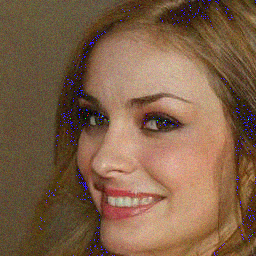

'Image at step 990'

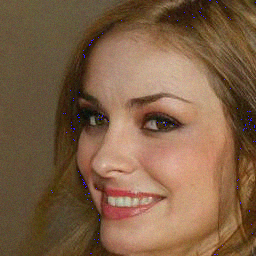

'Image at step 1000'

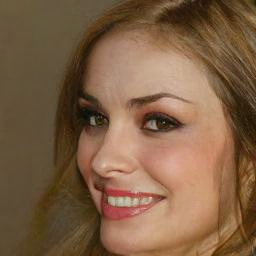

In [ ]:
sample = noisy_sample

for i, t in enumerate(tqdm(ddpm_scheduler.timesteps)):
  # 1. predizione del rumore residuale
  with torch.no_grad():
      residual = model(sample, t).sample

  # 2. calcolo dell'immagine meno rumorosa e impostazione x_t -> x_t-1
  sample = ddpm_scheduler.step(residual, t, sample).prev_sample

  # 3. mostra l'immagine ogni 10 step
  if (i + 1) % 10 == 0:
      display_sample(sample, i + 1)